In [37]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import numpy as np
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import Point
import geopandas as gpd
from cartopy.io import shapereader
import glob
import pandas as pd

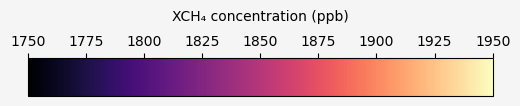

In [60]:
# Define color scale range and colormap
min_val = 1750
max_val = 1950
cmap = plt.colormaps.get_cmap("magma")

# Create a normalizer and scalar mappable
norm = colors.Normalize(vmin=min_val, vmax=max_val)
sm = cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Required for older matplotlib versions

# Create a figure with just the colorbar
fig, cax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)
# Set the background color of the figure
fig.set_facecolor('whitesmoke')
# Add the colorbar
cbar = fig.colorbar(sm, cax=cax, orientation='horizontal')
cbar.ax.xaxis.set_label_position('top')
cbar.ax.xaxis.tick_top()
cbar.set_label("XCH₄ concentration (ppb)", labelpad = 10)  # Optional: label for context
plt.savefig('colour_bar.png', dpi = 300,  bbox_inches='tight')

plt.show()

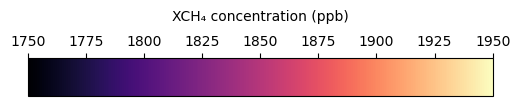

In [38]:
# Define color scale range and colormap
min_val = 1750
max_val = 1950
cmap = plt.colormaps.get_cmap("magma")

# Create a normalizer and scalar mappable
norm = colors.Normalize(vmin=min_val, vmax=max_val)
sm = cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Required for older matplotlib versions

# Create a figure with just the colorbar
fig, cax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)

# Add the colorbar
cbar = fig.colorbar(sm, cax=cax, orientation='horizontal')
cbar.ax.xaxis.set_label_position('top')
cbar.ax.xaxis.tick_top()
cbar.set_label("XCH₄ concentration (ppb)", labelpad = 10)  # Optional: label for context
plt.savefig('colour_bar.png', dpi = 300,  bbox_inches='tight')

plt.show()

In [ ]:
SEA_COLOR = "royalblue"     # lighter than darkblue
# or
SEA_COLOR = "mediumblue"    # still dark, but lighter
# or
SEA_COLOR = "cornflowerblue"  # even lighter

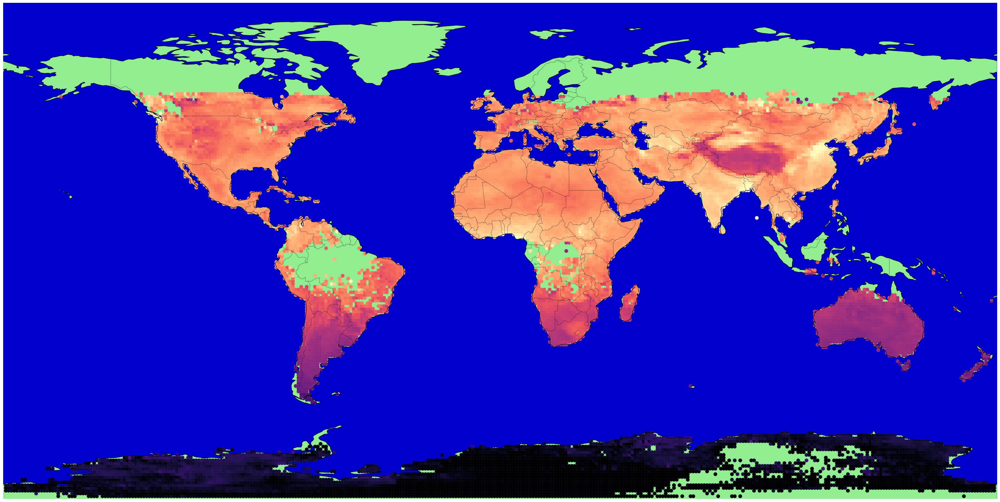

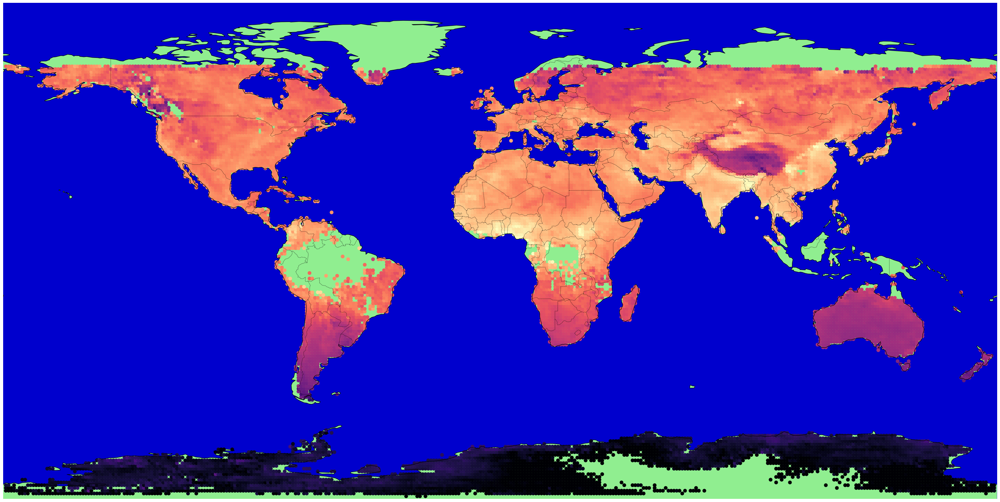

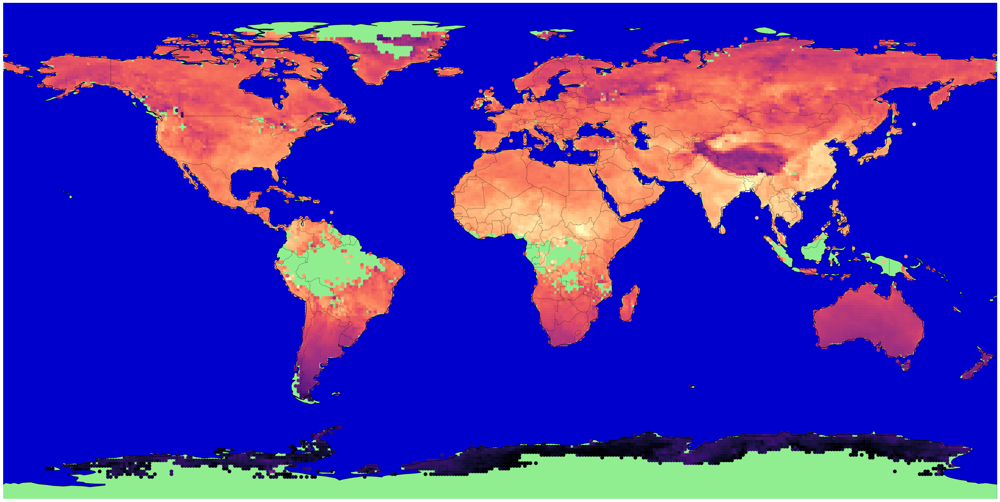

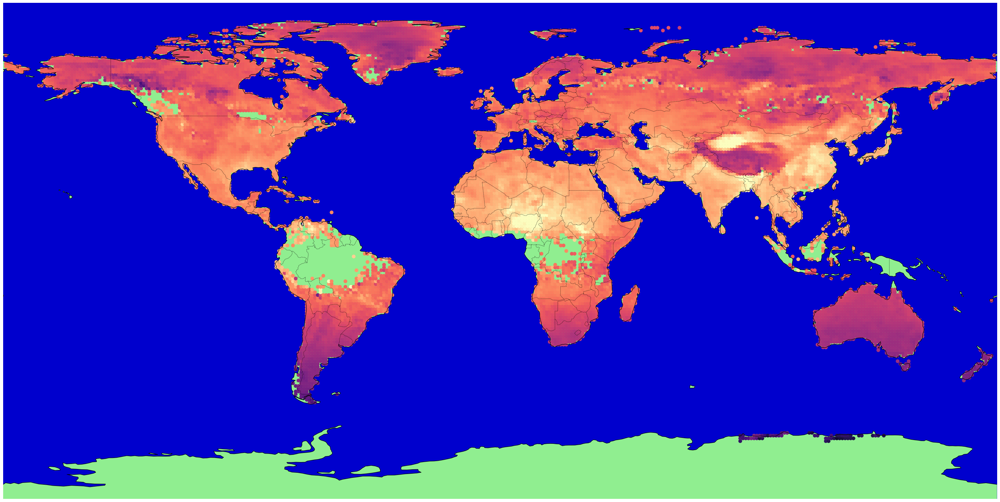

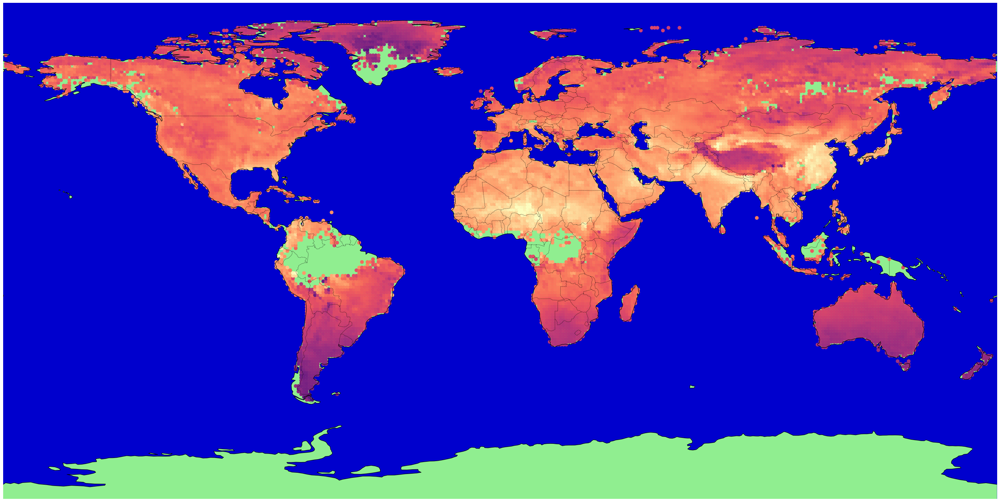

...

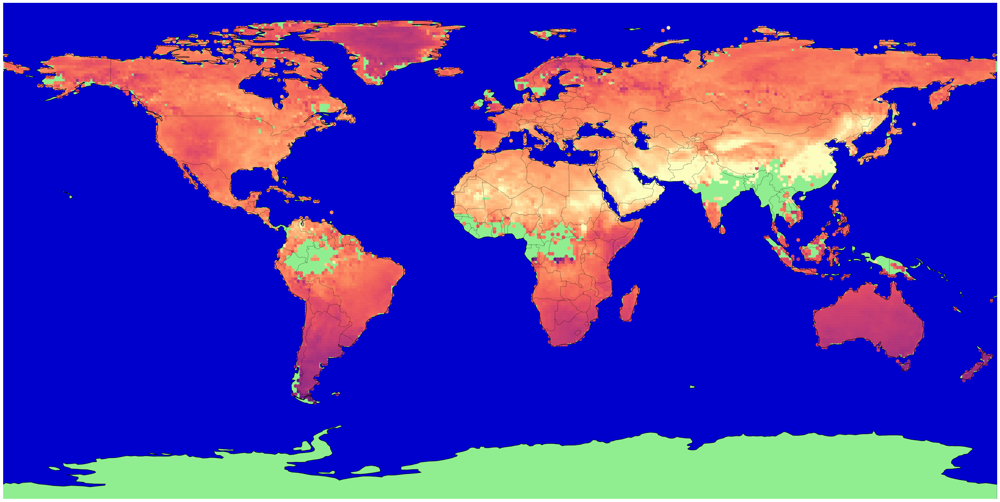

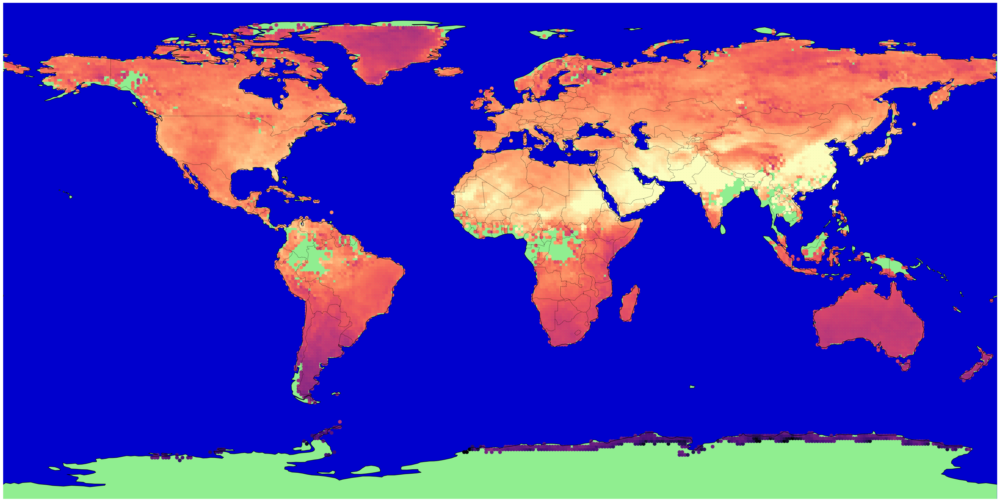

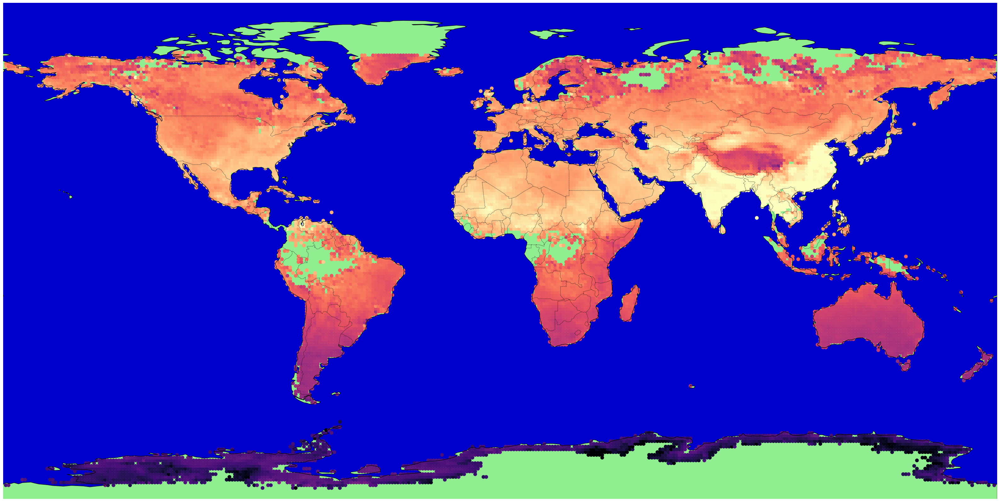

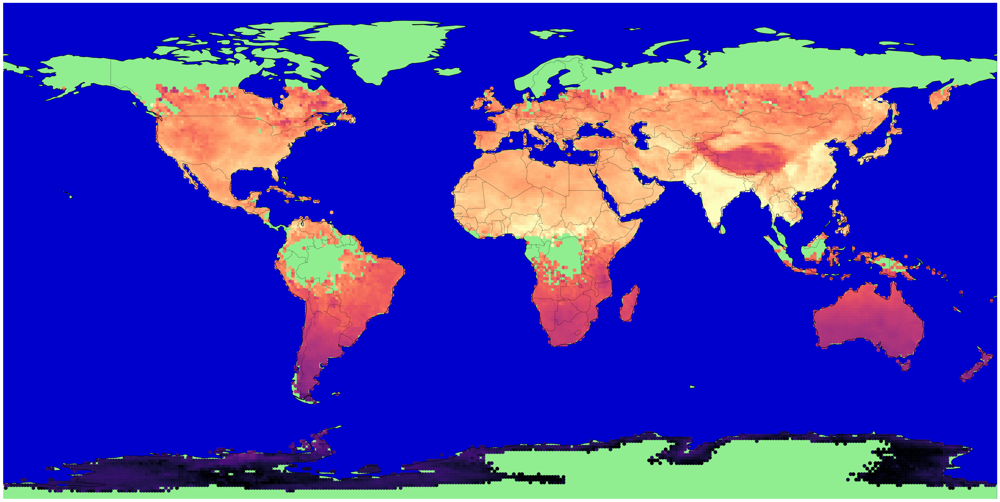

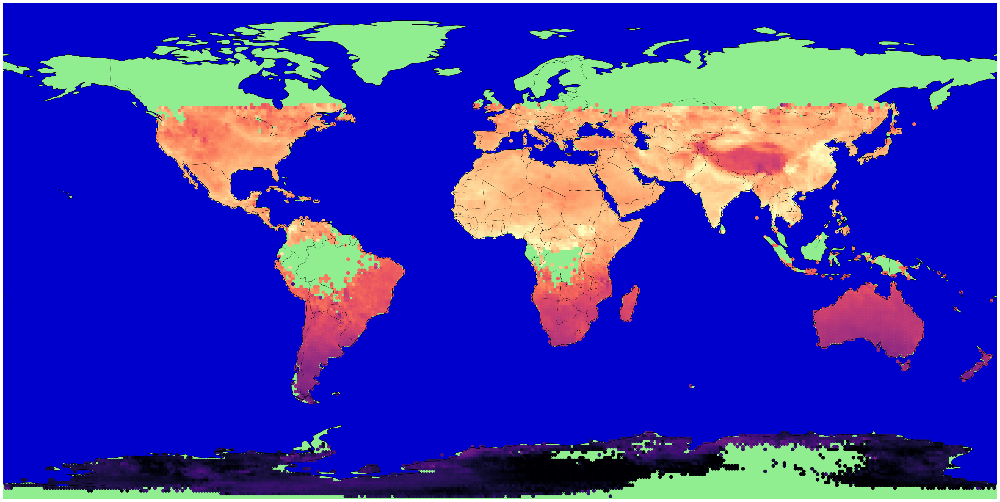

In [54]:
# ========== USER-DEFINED COLOURS ==========
# SEA_COLOR = "darkblue"     # Change sea color here
# SEA_COLOR = "royalblue" 
SEA_COLOR = "mediumblue"  
# SEA_COLOR = "cornflowerblue"
# SEA_COLOR = (0, 0, 139/255, 0.75)  # darkblue with 75% opacity

# LAND_COLOR = "palegreen"        # Change land color here
LAND_COLOR = "lightgreen" 
# LAND_COLOR = (0, 1.0, 0, 0.4)  # RGB for green + alpha

BORDER_COLOR = "black"      # Country border color
COASTLINE_COLOR = "black"   # Coastline color

#=======================================================================

folder_list = ['January','February','March', 'April', 'May', 'June']
folder_list = ['01','02', '03', '04', '05', '06', '07', '08', '09','10','11','12']

# Define your fixed minimum and maximum scale values
# min_val = 1750 
# max_val = 1950
min_val = 1750 
max_val = 1950

for folder in folder_list:

    # Find all NetCDF files in the folder
    file_list = sorted(glob.glob('Data/' + folder + '/*.nc'))
    
    # Initialize empty list to collect DataFrames
    df_list = []
    
    # Loop over each file
    for f_name in file_list:
        ds = xr.open_dataset(f_name)
    
        # Extract variables
        lat = ds['latitude']
        lon = ds['longitude']
        xch4 = ds['xch4']
    
        # Mask invalid values
        valid = (xch4 > 0) & (~xch4.isnull())
        lat_valid = lat.where(valid, drop=True)
        lon_valid = lon.where(valid, drop=True)
        xch4_valid = xch4.where(valid, drop=True)
    
        # Round lat/lon to 2 decimal places to bin similar points
        lat_rounded = lat_valid.round(0)   # use 0 if coarse binning is okay; 2 if you want finer grouping
        lon_rounded = lon_valid.round(0)
    
        # Create DataFrame
        df = pd.DataFrame({
            'lat': lat_rounded.values,
            'lon': lon_rounded.values,
            'xch4': xch4_valid.values
        }).dropna()
    
        df_list.append(df)
    
    # Concatenate all DataFrames
    all_data = pd.concat(df_list, ignore_index=True)
    
    # Group by (lat, lon) and calculate mean
    mean_df = all_data.groupby(['lat', 'lon'], as_index=False).mean()

    #Plot the mean dataframe __________________________________________________________
    dpi = 96
    width_in = 4096 / dpi
    height_in = 2048 / dpi

    # Extract data from mean_df
    lat = mean_df['lat'].values
    lon = mean_df['lon'].values
    xch4 = mean_df['xch4'].values
    
    # Load land polygons for masking
    land = gpd.read_file("shapefiles/ne_10m_admin_0_countries.shp")  # Adjust path if needed
    
    # Convert lat/lon to Point geometries
    points = gpd.GeoSeries([Point(lon[i], lat[i]) for i in range(len(lat))], crs="EPSG:4326")
    
    # Create GeoDataFrame
    points_gdf = gpd.GeoDataFrame(geometry=points)
    
    # Spatial join to keep only land points
    land_points = gpd.sjoin(points_gdf, land, how="inner", predicate="within")
    
    # Extract only valid land indices
    valid_indices = land_points.index
    lat_land = lat[valid_indices]
    lon_land = lon[valid_indices]
    xch4_land = xch4[valid_indices]
    
    # Plot
    fig = plt.figure(figsize=(width_in, height_in), dpi=dpi)
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.set_global()
    ax.set_facecolor(SEA_COLOR)  # Define SEA_COLOR as needed
    
    # Add land layer
    ax.add_feature(cfeature.LAND.with_scale('110m'), facecolor=LAND_COLOR, edgecolor='none')  # Define LAND_COLOR
    
    # Scatter plot
    sc = ax.scatter(
        lon_land, lat_land, c=xch4_land, s=62,
        cmap="magma", transform=ccrs.PlateCarree(),
        vmin=min_val,  # Sets the minimum of the color scale
        vmax=max_val   # Sets the maximum of the color scale
    )
    
    # Add borders and coastlines
    ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor=BORDER_COLOR)  # Define BORDER_COLOR
    ax.add_feature(cfeature.COASTLINE, edgecolor=BORDER_COLOR)
    
    # Add colorbar
    # plt.colorbar(sc, ax=ax, orientation='vertical', label='Mean XCH₄')
    # Remove ticks and frame
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)
    plt.savefig('mean_figures/2023/' + folder + '_xch4.png', dpi = 96, bbox_inches='tight', pad_inches=0)
    plt.show()
    
    # fig = plt.figure(figsize=(width_in, height_in), dpi=dpi)
    
    # ax = plt.axes(projection=ccrs.PlateCarree())

    # # Added parts for Land Masking _______________________________________________________

    # # Extract data from mean_df
    # lat = mean_df['lat'].values
    # lon = mean_df['lon'].values
    # xch4 = mean_df['xch4'].values
    
    # ax.set_global()
    # ax.set_facecolor(SEA_COLOR)  # Sea background color
    # # Add land as a white shape layer
    # ax.add_feature(cfeature.LAND.with_scale('110m'), facecolor=LAND_COLOR, edgecolor='none')
    
    
    # sc = ax.scatter(
    #     mean_df['lon'], mean_df['lat'],
    #     c=mean_df['xch4'],
    #     s=40,
    #     cmap="magma",
    #     transform=ccrs.PlateCarree(),
        # vmin=min_val,  # Sets the minimum of the color scale
        # vmax=max_val   # Sets the maximum of the color scale
    # )
    
    # ax.coastlines()
    # ax.add_feature(cfeature.BORDERS, linestyle=':')
    # ax.set_global()
    
    # plt.colorbar(sc, label="XCH4 (ppb)")
    # plt.title("TROPOMI CH₄ Column (Averaged by 0.01° Grid)")
    
    # plt.savefig('mean_figures/' + folder + '_coarse_scale_set_cbar.png', dpi = 96)

#### Plot Mean Df

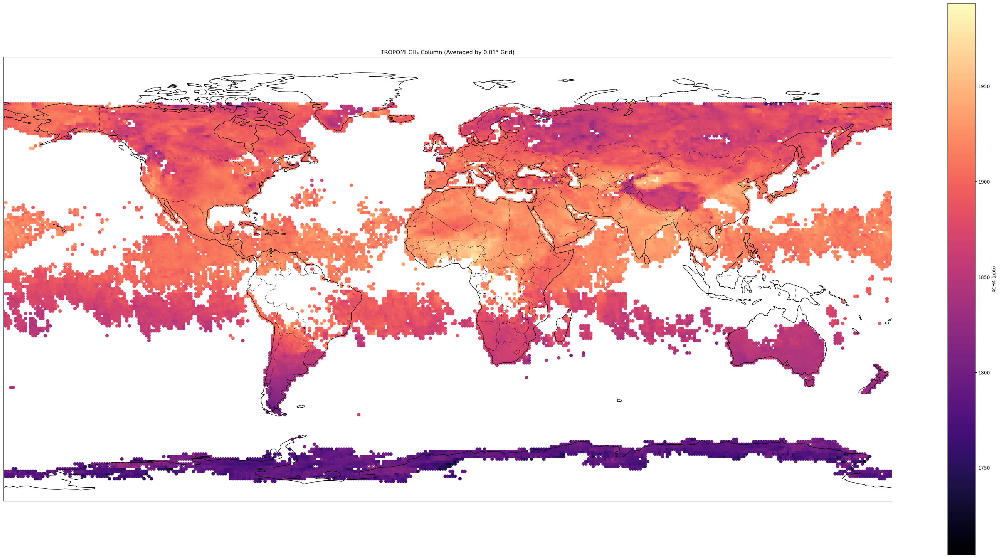

In [18]:
dpi = 96
width_in = 4096 / dpi
height_in = 2048 / dpi

fig = plt.figure(figsize=(width_in, height_in), dpi=dpi)

ax = plt.axes(projection=ccrs.PlateCarree())

sc = ax.scatter(
    mean_df['lon'], mean_df['lat'],
    c=mean_df['xch4'],
    s=40,
    cmap="magma",
    transform=ccrs.PlateCarree()
)

ax.coastlines()
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.set_global()

plt.colorbar(sc, label="XCH4 (ppb)")
plt.title("TROPOMI CH₄ Column (Averaged by 0.01° Grid)")

plt.savefig('Jan_mean_figure_coarse_with_scale.png', dpi = 96)
plt.show()

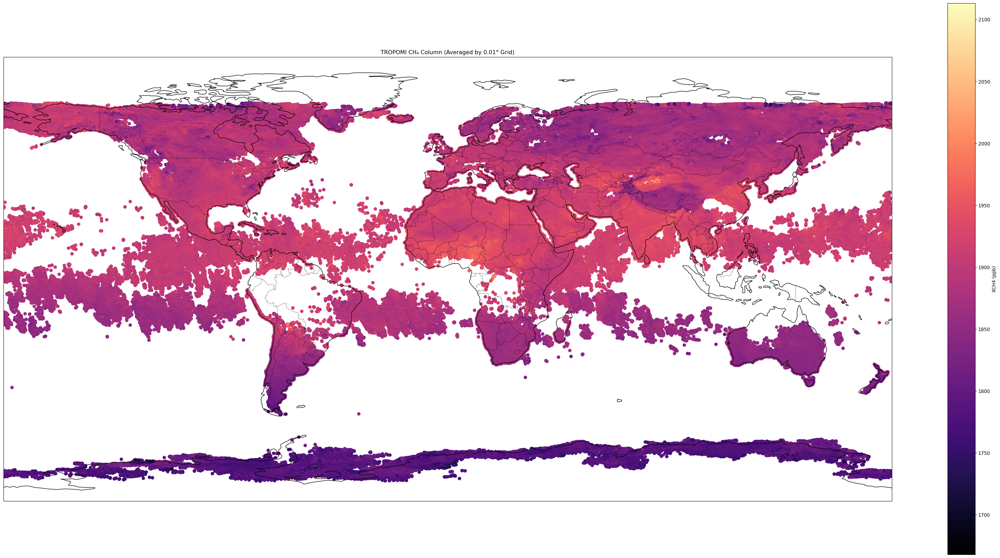

In [14]:
dpi = 96
width_in = 4096 / dpi
height_in = 2048 / dpi

fig = plt.figure(figsize=(width_in, height_in), dpi=dpi)

ax = plt.axes(projection=ccrs.PlateCarree())

sc = ax.scatter(
    mean_df['lon'], mean_df['lat'],
    c=mean_df['xch4'],
    s=40,
    cmap="magma",
    transform=ccrs.PlateCarree()
)

ax.coastlines()
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.set_global()

plt.colorbar(sc, label="XCH4 (ppb)")
plt.title("TROPOMI CH₄ Column (Averaged by 0.01° Grid)")

# plt.savefig('mean_figure_large_rounding_xLscatter_size.png', dpi = 96)
plt.show()